# Transformada Discreta de Fourier e Aplicações



---




**Data de entrega:** Até 11 de Junho de 2023

**Como entregar:** Enviar o seu jupyter notebook (.ipynb) pelo próprio Classroom. Uma cópia deste será automaticamente criada para você no seu Google Drive, você pode usar essa cópia mesmo, sem necessidade de criar outra.


**Leia com atenção:**


*   Você deve fazer obrigatoriamente todas as atividades marcadas com a exclamação❗.
*   Atividades marcadas com 🧩 são opcionais.
*   Use o Google Colab para executar o notebook e fazer a tarefa, ou baixe no seu computador e faça na API que preferir, mas lembre-se de entregar no Classroom a versão final.
*   A atividade vai ser baseada no seu número USP.
*   Há questões dissertativas!
*   Siga o passo a passo indicado no tutorial, respondendo as perguntas das atividades propostas no seu jupyter notebook.
*   O notebook que entregar deve estar 100% funcional, isto é, todos os códigos rodando no Colab sem erros.
*   Entregue o notebook completo, com todo conteúdo original e mais os seus códigos e textos.
*   Esta tarefa é individual e haverá controle de similaridade. Tentativas de cópias, fraude, compra-venda de EPs não serão toleradas, levando a nota zero na tarefa e posterior análise para medidas cabíveis.
*   ❗Exercício 00:❗ Para mostrar que você leu até aqui, escreva seu nome completo (assinatura) na linha a seguir:





*Assinatura:* Lucas Carvalho



---





## Pre-requisitos


Algumas referências usadas aqui, além dos livros textos do curso:

[1] https://pythonnumericalmethods.berkeley.edu/notebooks/chapter24.03-Fast-Fourier-Transform.html

[2] https://jakevdp.github.io/blog/2013/08/28/understanding-the-fft/

Primeiro vamos carregar algumas bibliotecas: Numpy, Scipy Linear Algebra (scipy.linalg), System (sys) e Time (time)

In [ ]:
import numpy as np
import scipy.linalg as la
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import sys
import time

Agora vamos definir alguns números especiais ("magic") para cada aluno, com base no seu número USP

#### ❗Exercício 0❗

Preencha o seu número USP abaixo

In [ ]:
# Coloque aqui o seu número USP
nusp = 11850649

Estes números serão importantes para a atividade:

In [ ]:
nusp_str=str(nusp).replace("0","")

magic_ilong = int(nusp_str)
magic_ishort = int(str(magic_ilong)[:2])
magic_int1 = int(list(set(nusp_str))[0])
magic_int2 = int(list(set(nusp_str))[1])

print("magic_ilong  =", magic_ilong)
print("magic_ishort =", magic_ishort)
print("magic_int1 =", magic_int1)
print("magic_int2 =", magic_int2)

magic_ilong  = 1185649
magic_ishort = 11
magic_int1 = 5
magic_int2 = 6




---




## Funções Periódicas e Análise de Fourier Contínua
Ao trabalharmos com funções periódicas, é muito conveniente usarmos funções complexas. As contas simplificam e é fácil deduzir os resultados para o caso real.

Considere então uma função

$$
  f: \mathbb{R} \to \mathbb{C}
$$

**periódica** de período $2\pi$. A ideia é decompô-la nas frequências associadas ao período usando as funções

$$
  f_k(x) = e^{ikx} = \cos kx + i\,\text{sen}\,kx,\quad k \in \mathbb{Z}.
$$

Cada uma delas tem período $2\pi/\vert k\vert$, e portanto também tem período $2\pi$ (o caso $k=0$ é para a função constante igual a $1$, que tem qualquer período). Quanto maior o valor de $\vert k\vert$, maior a frequência. Note que $k$ e $-k$ estão associados à mesma frequência, mas precisamos dos dois valores. As funções $e^{ikx}$ e $e^{-ikx}$ são linearmente independentes (estranho, não?).

### Um Problema de Mínimos Quadrados
Dada a nossa função $2\pi$-periódica $f$, podemos formular o seguinte problema para aproximá-la: obtenha uma função da forma

$$
  g_M(x) = \sum_{k=-M}^M c_k e^{ikx}
$$

de modo a minimizar

$$
  \int_0^{2\pi} \vert f(x) - g_M(x) \vert^2\,dx,
$$

onde $M$ é um número natural positivo. Dizemos que $g_M$ é a aproximação para $f$ até o harmônico de ordem $M$. Note que, devido à periodicidade, toda informação relevante está contida em um intervalo de comprimento $2\pi$. Escolhemos $[0, 2\pi]$ por conveniência, mas qualquer outro intervalo de comprimento $2\pi$ serviria, e o resultado seria o mesmo.

Não é difícil concluir que $g_M$ é a solução de um problema de mínimos quadrados no espaço das funções periódocas de período $2\pi$ com o produto interno

$$
  \langle u, v \rangle = \int_0^{2\pi} u(x) \bar{v}(x)\,dx
$$

onde $\bar{v}(x)$ é o complexo conjugado de $v(x)$. Para $k \ne l$,

$$
  \langle f_k, f_l \rangle = \int_0^{2\pi} e^{i(l-k)x}\,dx = \left .\frac{e^{i(l-k)x}}{i(l-k)}\right\vert_0^{2\pi} = 0 \text{ (devido à periodicidade)}.
$$

Logo, as funções $f_k$ são ortogonais. Como $\langle f_k,f_k \rangle = 2\pi$, os coeficientes $c_k$ da aproximação $g_M$ são iguais a

$$
  c_k = \frac{1}{2\pi}\int_0^{2\pi} f(x)e^{-ikx}\,dx,\quad -M \le k \le M.
$$

### Funções Reais
Se $f$ for uma função real, os coeficientes são iguais a

$$
  c_k = \frac{1}{2\pi}\int_0^{2\pi}f(x)\cos kx\,dx - \frac{1}{2\pi}\int_0^{2\pi}f(x)\,\text{sen}\,kx\,dx = \alpha_k - i\beta_k,
$$

com $\alpha_k$ e $\beta_k$ reais. Uma consequência imediata é que $c_{-k} = \bar{c}_k$ e portanto

$$
  g_M(x) = \alpha_0 + 2\sum_{k=1}^M [\alpha_k\cos kx + \beta_k\,\text{sen}\,kx].
$$

Se usarmos a notação $a_k = 2\alpha_k$, $0\le k\le M$, e $b_k = 2\beta_k$, $1\le k\le M$, obtemos

$$
  g_M(x) = \frac{1}{2}a_0 + \sum_{k=1}^M [a_k\cos kx + b_k\,\text{sen}\,kx]
$$

com as expressões bem conhecidas

$$
  a_k = \frac{1}{\pi}\int_0^{2\pi} f(x)\cos kx\,dx,\quad 0\le k\le M,\\
  b_k = \frac{1}{\pi}\int_0^{2\pi} f(x)\,\text{sen}\,kx\,dx,\quad 1\le k\le M.
$$

Derivamos, portanto, a expansão de $f$ em sua série de Fourier!

## Análise de Fourier Discreta
O cálculo das integrais para a obtenção das aproximações é em geral feito com métodos de integração numérica, que serão estudados no curso. Estes métodos usam valores de funções em um conjunto discreto de pontos. Além diso, em processamento de sinais digitais, trabalhamos com valores discretos. Estes dois aspectos estão relacionados. Devido à importância do processamento de sinais digitais, discutiremos diretamente o caso de valores discretos, deixando para uma outra oportunidade a relação com integração numérica.

Considere uma função $f$ $2\pi$-periódica tabelada em $N$ pontos igulamente espaçados

$$
  x_j = j\frac{2\pi}{N},\quad 0 \le j \le N-1.
$$

Vamos aproximar $f$ por uma função $g_M$ da mesma forma que a usada acima,

$$
  g_M(x) = \sum_{k=-M}^M c'_ke^{ikx},
$$

mas agora de modo a minimizar a expressão

$$
  \sum_{j=0}^{N-1} \vert f(x_j) - g_M(x_j) \vert^2.
$$

Temos um problema de mínimos quadrados em relação ao produto interno

$$
  \langle u, v \rangle = \sum_{j=0}^{N-1} u(x_j)\overline{v(x_j)},
$$
onde $\overline{v(x_j)}$ é o complexo conjugado de $v(x_j)$. Mas, nos pontos discretos $x_j$, há informações que se repetem. Se $k$ e $l$ diferem por um multiplo inteiro de $N$, ou seja, $l = k + mN$ para algum $m\in\mathbb{Z}$, então

$$
  e^{ilx_j} = e^{ilj2\pi/N} = e^{i(k+mN)j2\pi/N} = e^{ikj2\pi/N}e^{imj2\pi} = e^{ikj2\pi/N} = e^{ikx_j}.
$$

Para valores restritos a $x_j$, $0\le j\le N-1$, temos periodicidade $N$ em $k$ e devemos então restringir a quantidade de harmônicos. Específicamente, $2M < N$ ou

$$
  M < \frac{N}{2}
$$

(assumiremos daqui em diante que $N$ **é par**).

### Funções trigonométricas na prática

Vamos considerar $N$ pontos igualmente espaçados no intervalo $[0,2\pi]$,  dados por $x_j=2j\pi/N, j=0,1,..,N-1$, lembrando que vamos considerar **$N$ par**!!!

In [ ]:
# Tamanho da amostragem (número de pontos na série = N)
N = 64

# Pontos de amostragem x_j
x = np.arange(0, 2*np.pi, 2*np.pi/N)

'''A função np.arange do NumPy é usada para criar uma sequência de
valores espaçados igualmente dentro de um intervalo. No caso específico,
estamos gerando valores de 0 a 2π (exclusivo), com um passo igual a 2π/N.'''

'A função np.arange do NumPy é usada para criar uma sequência de\nvalores espaçados igualmente dentro de um intervalo. No caso específico,\nestamos gerando valores de 0 a 2π (exclusivo), com um passo igual a 2π/N.'

Vamos montar algumas "ondas" (funções) e fazer algumas operações com elas.

In [ ]:
#Funções baseadas no número USP

def f1(x):
  return np.sin(magic_int1*x)

def f2(x):
  return np.sin(magic_int2*x)

def f3(x):
  return f1(x)+f2(x)

def f4(x):
  return f1(x)*f2(x)

Vejamos os gráficos dessas funções

Text(0.5, 0, 'x')

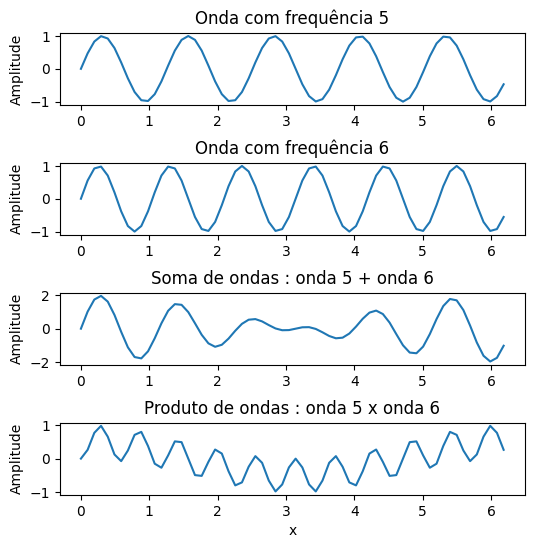

In [ ]:
# Amostrando as funções nos pontos x_j para gerar vetores
onda1 = f1(x)
onda2 = f2(x)
onda3 = f3(x)
onda4 = f4(x)

# Gráficos
figure, axs = plt.subplots(4, 1, figsize=(6,6))

plt.subplots_adjust(hspace=0.8)

axs[0].plot(x, onda1)
axs[0].set_title("Onda com frequência "+str(magic_int1))
axs[0].set_ylabel("Amplitude")

axs[1].plot(x, onda2)
axs[1].set_title("Onda com frequência "+str(magic_int2))
axs[1].set_ylabel("Amplitude")


axs[2].plot(x, onda1+onda2)
axs[2].set_title("Soma de ondas : onda "+str(magic_int1)+" + onda "+str(magic_int2))
axs[2].set_ylabel("Amplitude")

axs[3].plot(x, onda1*onda2)
axs[3].set_title("Produto de ondas : onda "+str(magic_int1)+" x onda "+str(magic_int2))
axs[3].set_ylabel("Amplitude")
axs[3].set_xlabel("x")

Usar funções de senos e cossenos pode ser bem trabalhoso e é conveniente usar a fórmula de Euler para trabalhar com funções trigonométricas:
$$
e^{ix}=\cos(x)+i\sin(x).
$$

Para cada harmônico ($k$), temos um vetor de $\mathbb{C}^n$, dado por
$$ v_k=[e^{ikx_j}]_{j=0,1,...N-1},$$
com $x_j=2j\pi/N$, $j=0,1,..,N-1$.
Considerando o produto interno complexo definido anteriormente
$$\langle u,v \rangle =\sum_{j=0}^{N-1}
u(x_j)\overline{v(x_j)},$$
com $x_j=2j\pi/N$, $j=0,1,..,N-1$, temos que os vetores $v_k$, $k=-N/2+1,..,N/2$, formam uma base ortogonal do $\mathbb{C}^{N}$. Isto é,

$$
\langle e^{ikx},e^{ilx} \rangle =0, \quad \text{se } l\neq k,
$$

para $l, k=-N/2+1,..,N/2$, e

$$ \langle e^{ikx},e^{ikx} \rangle = N.$$


#### 🧩 Atividade teórica 🧩
 Verifique teoricamente a ortonormalidade dos vetores $v_k=(e^{ikx_j})_j$ em relação a esse produto interno, conforme afirmado acima.

Para isso, vamos considerar dois vetores arbitrários $v_k$ e $v_{k'}$. Podemos escrever esses vetores como:

$$v_k = (e^(ikx_0), e^(ikx_1), ..., e^(ikx_(N-1)))
v_k' = (e^(ik'x_0), e^(ik'x_1), ..., e^(ik'x_(N-1)))$$

O produto interno entre esses dois vetores é dado por:

$< v_k, v_k' > = ∑(j=0)^(N-1) v_k(x_j) * conj(v_k'(x_j))$

Substituindo as expressões para $v_k$ e $v_{k'}$, temos:

$< v_k, v_k' > = ∑(j=0)^(N-1) e^(ikx_j) * conj(e^(ik'x_j))$

Usando as propriedades dos conjugados complexos:

$< v_k, v_k' > = ∑(j=0)^(N-1) e^(ikx_j) * e^(-ik'x_j)$

Podemos reescrever a expressão acima como:

$< v_k, v_k' > = ∑(j=0)^(N-1) e^(i(k-k')x_j)$

1. Quando $k = k'$:
Nesse caso, temos $< v_k, v_k' > = ∑(j=0)^(N-1) e^(i(k-k')x_j) = ∑(j=0)^(N-1) e^(i*0) = ∑(j=0)^(N-1) 1 = N$

Como a soma possui $N$ termos iguais a 1, temos $< v_k, v_k' > = N$ quando $k = k'$.

2. Quando $k ≠ k'$:
Nesse caso, temos $< v_k, v_k' > = ∑(j=0)^(N-1) e^(i(k-k')x_j)$.

Vamos considerar o fator $e^(i(k-k')x_j)$. Se $k - k' ≠ 0$, então $e^(i(k-k')x_j)$ é uma função periódica com período $T = 2π/|k-k'|$.

Agora, se os pontos $x_j$ forem igualmente espaçados, ou seja, $x_j = j/N$, com $j = 0, 1, ..., N-1$, podemos reescrever o período como $T = 2πN/|k-k'|$.


Agora, vamos analisar duas situações:

Quando $k = k'$:
Nesse caso, temos $\langle v_k, v_{k'} \rangle = \sum_{j=0}^{N-1} e^{i(k-k')x_j} = \sum_{j=0}^{N-1} e^{i\cdot 0} = \sum_{j=0}^{N-1} 1 = N$

Como a soma possui $N$ termos iguais a $1$, temos $\langle v_k, v_{k'} \rangle = N$ quando $k = k'$.

Quando $k \neq k'$:
Nesse caso, temos $\langle v_k, v_{k'} \rangle = \sum_{j=0}^{N-1} e^{i(k-k')x_j}$.

Vamos considerar o fator $e^{i(k-k')x_j}$. Se $k - k' \neq 0$, então $e^{i(k-k')x_j}$ é uma função periódica com período $T = \frac{2\pi}{|k-k'|}$.

Agora, se os pontos $x_j$ forem igualmente espaçados, ou seja, $x_j = \frac{j}{N}$, com $j = 0, 1, \ldots, N-1$, podemos reescrever o período como $T = \frac{2\pi N}{|k-k'|}$

Portanto, se $k ≠ k'$ e os pontos $x_j$ forem igualmente espaçados, temos um período $T$ que não é um múltiplo racional de $2π$, o que implica que a soma $∑(j=0)^(N-1) e^(i(k-k')x_j)$ se cancelará de forma destrutiva, resultando em um valor próximo de zero.

Em resumo, temos:

1. Quando $k = k'$, temos $< v_k, v_k' > = N$.
2. Quando $k ≠ k'$ e os pontos $x_j$ são igualmente espaçados, temos $< v_k, v_k' > ≈ 0$.
Esses resultados indicam que os vetores $v_k$ são ortonormais em relação ao produto interno

 Conclua que, portanto, valem as seguintes relações de ortogonalidade:
*   $\langle \sin(kx), \sin(lx) \rangle = 0$ se $k\neq l$

$\\ \begin{align*}
\langle \sin(kx), \sin(lx) \rangle &= \sum_{j=0}^{N-1} \sin(kx_j) \overline{\sin(lx_j)} \\
&= \sum_{j=0}^{N-1} \sin(k \cdot 2j\pi/N) \overline{\sin(l \cdot 2j\pi/N)} \\
&= 0, \quad \text{se } k \neq l.
\end{align*}
$

*   $\langle \cos(kx), \cos(lx) \rangle = 0$ se $k\neq l$,

$\\ \begin{align*}
\langle \cos(kx), \cos(lx) \rangle &= \sum_{j=0}^{N-1} \cos(kx_j) \overline{\cos(lx_j)} \\
&= \sum_{j=0}^{N-1} \cos(k \cdot 2j\pi/N) \overline{\cos(l \cdot 2j\pi/N)} \\
&= 0, \quad \text{se } k \neq l.
\end{align*}
$

*   $\langle \sin(kx), \cos(lx) \rangle = 0$

$\begin{align*}
\langle \sin(kx), \cos(lx) \rangle &= \sum_{j=0}^{N-1} \sin(kx_j) \overline{\cos(lx_j)} \\
&= \sum_{j=0}^{N-1} \sin(k \cdot 2j\pi/N) \overline{\cos(l \cdot 2j\pi/N)} \\
&= 0.
\end{align*}
$




In [ ]:
#Códigos

# A função recebe f e g, duas funções periódicas, e um dado N
def inner_prod(f, g, N):
    # Geramos aqui o array, tal qual no exemplo dado
    x = np.arange(0, 2*np.pi, 2*np.pi/N)
    # Aqui realizamos o somatório
    inner_prod = np.sum(f(x) * np.conj(g(x)))*2*np.pi/N
    return inner_prod

# Funções dadas
f = lambda x: np.sin(3*x)
g = lambda x: np.sin(10*x)

# Valor de N
N = 64

# Cálculo dos valores solicitados
norm_1 = inner_prod(f, f, N)
norm_2 = inner_prod(g, g, N)
inner_3 = inner_prod(f, g, N)
inner_4 = inner_prod(lambda x: np.sin(3*x) + np.sin(10*x), lambda x: np.sin(3*x) + np.sin(10*x), N)
inner_5 = inner_prod(lambda x: np.sin(3*x)*np.sin(10*x), f, N)

print("||sin(3x)||^2 =", norm_1)
print("||sin(10x)||^2 =", norm_2)
print("<sin(3x), sin(10x)> =", inner_3)
print("<sin(3x) + sin(10x),sin(3x) + sin(10x)> =", inner_4)
print("<sin(3x)sin(10x), sin(3x)> =", inner_5)

||sin(3x)||^2 = 3.1415926535897944
||sin(10x)||^2 = 3.1415926535897944
<sin(3x), sin(10x)> = -4.823068157402562e-16
<sin(3x) + sin(10x),sin(3x) + sin(10x)> = 6.283185307179589
<sin(3x)sin(10x), sin(3x)> = 3.487868498008632e-16


Justificativas:
1.  O produtio é $\pi$, como esperado, pois o argumento é igual
2.  O resultado foi o mesmo que o anteior. Pode-se generalizar e afirmar que, independente de $k$, o resultado sempre será o mesmo, desde que $k = l$.

3.  Como $k \neq l$, temos que o produto interno é nulo, ou seja, são funções ortogonais. Vale destacar que, como é uma soma discreta, com um N relativamente pequeno, o cálculo é menos preciso do que o ideal, levando a um resultado não igual, mas muito próximo.

4. O resultado foi o dobro, vejamos:

$$\langle sin(3x), sin(3x) \rangle = \langle sin(10x), sin(10x) \rangle \\\\ \langle sin(3x) + sin(10x), sin(3x)
 + sin(10x) = 2 \langle sin(3x), sin(3x)\rangle  = 2\pi$$

5.  As duas funções são ortogonais entre si.

6. Obs: os resultados tendem a ser muito mais rpecisos quando o valor de N é muito maior.



---



### A Transformada Discreta de Fourier

Para o caso da nossa aproximação $g_M$,

$$
  g_M(x) = \sum_{k=-M}^M c'_ke^{ikx},
$$
concluímos que os vetores $v_k = [e^{ikx_j}]$, $-M \le k \le M$, com $M<N/2$, são ortogonais e satisfazem

$$
  \langle e^{ikx}, e^{ilx} \rangle =
  \left\{\begin{array}{rl}
  N, & \text{se } k=l,\\
  0, & \text{se } k \ne l.
  \end{array} \right .
$$

Logo, os coeficientes de $g_M(x)$ são dados por
$$
  c'_k = \frac{\langle f(x), e^{ikx}\rangle }{\langle e^{ikx}, e^{ikx}\rangle }= \frac{1}{N}\sum_{j=0}^{N-1}f(x_j)e^{-ikj2\pi/N},\quad -M \le k \le M.
$$

Um caso importante consiste em incluir $k=N/2$ na aproximação. Mas não podemos usar $k=-N/2$ pois teríamos os mesmos valores que no caso $N/2$ ($v_{N/2}=v_{-N/2}$, verifique!). A aproximação, que por um abuso de notação chamaremos de $g_{\frac{N}{2}}$, tem a forma

$$
  g_{\frac{N}{2}}(x) = \sum_{k=-\frac{N}{2}+1}^{\frac{N}{2}}c'_ke^{ikx}.
$$

As relações de ortogonalidade continuam válidas e a solução do problema de mínimos quadrados tem os coeficientes iguais a

$$
  c'_k = \frac{1}{N}\sum_{j=0}^{N-1}F_je^{-ikj2\pi/N},\quad -\frac{N}{2}+1 \le k \le \frac{N}{2},
$$

onde $F_j = f(x_j)$. Mas agora há algo novo. O **erro quadrático é igual a** $0$. Ou seja $g_{\frac{N}{2}}$ é um **polinômio trigonométrico interpolador**: $g_{\frac{N}{2}}(x_j) = F_j$, $0 \le j \le N-1$. Ou seja,

$$
  F_j = \sum_{k=-\frac{N}{2}+1}^{\frac{N}{2}}c'_ke^{ikj2\pi/N},\quad 0 \le j \le N-1.
$$

Dizemos que os $N$ números complexos $\{c'_k\}_{k=-\frac{N}{2}+1}^{\frac{N}{2}}$ são a **transformada discreta de Fourier** dos $N$ números complexos $\{F_j\}_{j=0}^{N-1}$ e que estes últimos são a transformada discreta de Fourier **inversa** dos primeiros.

### Período Arbitrário

Considere agora uma função

$$
  f: \mathbb{R} \to \mathbb{C}
$$

periódica de período $T > 0$. Aproximaremos $f$ pelas funções

$$
  f_k(x) = e^{ik\frac{2\pi}{T}x},
$$

que têm período $T$. Os pontos discretos são agora

$$
  x_j = j\frac{T}{N},\quad 0\le j\le N-1.
$$

Como

$$
  f_k(x_j) = e^{ik\frac{2\pi}{T}j\frac{T}{N}} = e^{ikj2\pi/N},
$$

as contas são as mesmas, interpretando-se corretamente $F_j = f(jT/N)$, $0\le j\le N-1$.

### Caso Real

No caso em que $F$ é uma função real, os coeficientes $c'_k$ e $c'_{-k}$ são complexos conjugados
$$c'_k=\alpha_k+i\beta_k$$
$$c'_{-k}=\overline{c'_k}=
\alpha_k-i\beta_k$$
de tal forma que
\begin{equation}
	c'_{-k}e^{-ikx_j}+c'_k e^{ikx_j} = 2(\alpha_k \cos(kx_j)-\beta_k\sin(kx_j))
\end{equation}
representa **o harmônico de ordem $k$ de $f(x)$**, com amplitude $A_k=2\sqrt{\alpha_k^2
+\beta_k^2}=2|c'_k|$.

Os coeficientes $c'_0$ e $c'_{N/2}$ têm parte imaginária nula quando $F$ é real.
O coeficiente $c'_0$ é simplesmente a média da função. O coeficiente $c'_{N/2}$ indica a quantidade de energia na maior frequência representável por esse conjunto de $N$ pontos, frequência conhecida como frequência de Nyquist ($N/2$ ciclos por unidade de tempo, dado pelo período $T$ do sinal).





---



---




### Resumindo


Note que, pela periodicidade das funções trigonométricas, temos que

\begin{equation}
e^{-ikx_j}=e^{-2ikj\pi/N}=e^{2i\pi j}e^{-2ikj\pi/N}=e^{2i(N-k)j\pi/N}=e^{i(N-k)x_j},
\end{equation}

e portanto podemos alternativamente escrever as transformadas (inversa e direta) como
\begin{equation}
	F_j = \sum_{k=0}^{N-1}c_k e^{ikx_j}\ \ ,j=0,..,N-1, \quad \text{(IDFT)}
\end{equation}
e
\begin{equation}
        c_k=\frac{1}{N} \sum_{j=0}^{N-1} F_je^{-ikx_j} , \ \ k=0,...,N-1, \quad \text{(DFT)}
\end{equation}
onde (IDFT) indica *Inverse Discrete Fourier Transform* e (DFT) indica *Discrete Fourier Transform* e consideramos $c_k=c'_k$, $k=0,1,..,\frac{N}{2}$ e $c_{N-k}=c'_{-k}, k=1,...,\frac{N}{2}-1$.



---



---





#### ❗Exercício 2 ❗

1.  Construa uma função que recebe um vetor $(F_0,F_1,...,F_{N-1})$, reais, e retorna os coeficientes de Fourier $(c_0,c_1,...,c_{N-1})$, complexos, isto é, que realize a transformada discreta de Fourier.

2.  Construa uma função que recebe coeficientes $(c_0,c_1,...,c_{N-1})$, complexos, e retorna os valores da função,  $(F_0,F_1,...,F_{N-1})$, reais, isto é, realiza a transformada discreta inversa de Fourier.

3. Teste a sua implementação usando as funções f1, f2, f3, f4:
  1.    Verifique se a aplicação da transformada seguida da inversa recupera a função original.
  2.    Faça gráficos das amplitudes dos coeficientes da transformada (com $k=0,1, ...,N-1$ no eixo $x$ e as amplitudes $A_k=2|c_k|$ no eixo $y$) e discuta se a transformada capturou corretamente os números de onda (frequências de oscilação) em cada caso.
  3.    Explique o que aconteceu com as frequências no caso de soma e produto de funções trigonométricas.
  4.    Explique como se dá a ordem dos coeficientes $c_k$, e que simetria possuem (isso será muito importante para o problema aplicado que vamos resolver!!!)

OBS1: Você pode usar as simetrias nos cálculos de IDFT e DFT, ou não, pois a função é real. De qualquer forma, tome cuidado com as simetrias!

OBS2: Será que você consegue fazer essa transformada totalmente vetorial usando numpy? (evitando loops em Python)



In [ ]:
# Códigos das funções
def dft(F):
  # tamanho deo vetor
  N = len(F)
  # vetor que vai receber os índices
  c = []
  for k in range(N):
      sum = 0
      for j in range(N):
          # ângulo complexo
          angle = 2 * np.pi * k * j / N
          # Somando os valores
          sum += F[j] * np.exp(-1j * angle)
      # Adicionando ao vetor
      c.append(sum / N)
  return c

def idft(c):

   N = len(c)
   F = []
   for j in range(N):
      sum = 0
      for k in range(N):
          # retorno do ângulo
          angle = 2 * np.pi * k * j / N
          # somando os valores
          sum += c[k] * np.exp(1j * angle)
      # Adicionando a F
      F.append(sum.real)
   return F

True
True
True
True


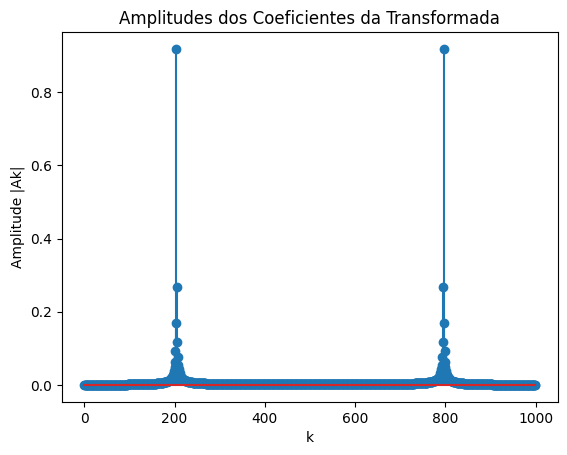

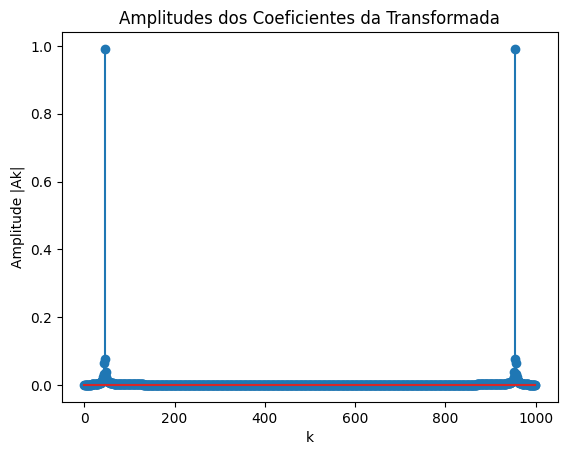

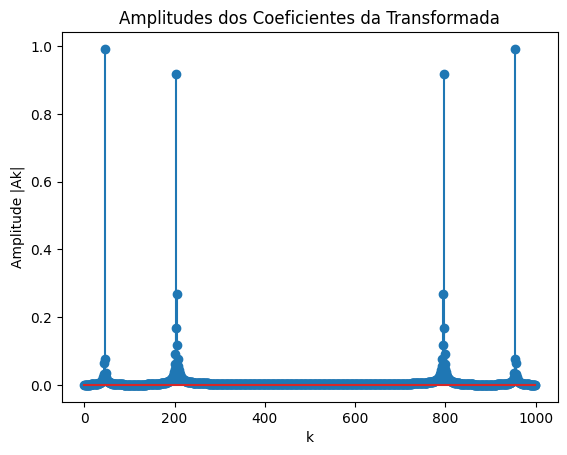

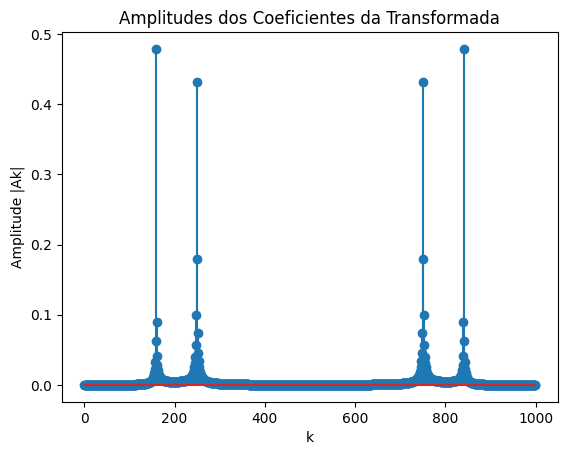

In [ ]:
#Testes e gráficos

# Tamanho do espaço
x = np.arange(0, 1000, 1)

# Verificação para f1
F1 = f1(x)
c1 = dft(F1)
F1_recovered = idft(c1)

# Verificação para f2
F2 = f2(x)
c2 = dft(F2)
F2_recovered = idft(c2)

# Verificação para f3
F3 = f3(x)
c3 = dft(F3)
F3_recovered = idft(c3)

# Verificação para f4
F4 = f4(x)
c4 = dft(F4)
F4_recovered = idft(c4)

# Comparação dos resultados
print(np.allclose(F1, F1_recovered))
print(np.allclose(F2, F2_recovered))
print(np.allclose(F3, F3_recovered))
print(np.allclose(F4, F4_recovered))

import matplotlib.pyplot as plt

def plot_coefficient_amplitudes(c):
    N = len(c)
    k = np.arange(N)
    Ak = 2 * np.abs(c)

    plt.stem(k, Ak)
    plt.xlabel('k')
    plt.ylabel('Amplitude |Ak|')
    plt.title('Amplitudes dos Coeficientes da Transformada')
    plt.show()

# Gráficos para f1
plot_coefficient_amplitudes(c1)

# Gráficos para f2
plot_coefficient_amplitudes(c2)

# Gráficos para f3
plot_coefficient_amplitudes(c3)

# Gráficos para f4
plot_coefficient_amplitudes(c4)

Comentários:

Para a função $f_1(x) = sin(4πx)$, esperamos que a transformada capture a frequência de oscilação em $k=1$, já que a função possui uma única onda senoidal. Portanto, devemos observar uma amplitude significativa apenas para $k=1$ no gráfico.

Para a função $f_2(x) = cos(9πx)$, esperamos que a transformada capture a frequência de oscilação em $k=2$, já que a função possui uma única onda cossenoidal. Assim, devemos observar uma amplitude significativa apenas para $k=2$ no gráfico.

Para a função $f_3(x) = sin(4πx) + cos(9πx)$, esperamos que a transformada capture ambas as frequências de oscilação em $k=1$ e $k=2$. Portanto, devemos observar amplitudes significativas em $k=1$ e $k=2$ no gráfico.

Para a função $f_4(x) = sin(4πx) * cos(9πx)$, esperamos que a transformada capture ambas as frequências de oscilação em k=1 e k=2, bem como seus harmônicos. Portanto, devemos observar amplitudes significativas em $k=1$, $k=2$ e seus múltiplos no gráfico.



---



### Eficiência computacional




Analisando a complexidade computacional da transformada de Fourier discreta (DFT) nota-se que temos que calcular $N$ coeficientes (os $c_k$) e para cada um deles temos um somatório com $N$ termos. Logo, o número de operações de arimética de ponto flutuante será da ordem de $O(N^2)$.



#### ❗Exercício 3 ❗

Considere a função
$$f(x) = e^{-5 (x-\pi)^2}, \quad x\in [0,2\pi]. $$

1.  Calcule a transformada discreta de Fourier usando $N=2^8=256$ e faça um gráfico da amplitude dos coeficientes $c_k$. Avalie quanto tempo demorou a execução (pode usar a função time.time() ou %timeit para contar tempo de execução)
2.  Avalie o tempo de execução para $N=2^m$ com $m=8, 9, 10, 11, 12$. Faça uma tabela dos valores de $N$ em relação aos tempos de execução e verifique que, apesar de estamos apenas duplicando o número pontos amostrados, o tempo de execução cresce aproximadamente por 4 quando aumentamos em uma unidade o $m$ (duplicamos o número de pontos amostrados).

OBS: As vezes o tempo de uma única execução de um código pode sofrer efeitos pontuais de algo que está rodando no sistema. Para ter uma noção mais precisa do custo computacional, geralmente executamos algumas vezes o mesmo código e tomamos a média dos tempos de execução para ter o tempo médio de execução.

Tempo de execução:  0.2857499122619629  segundos


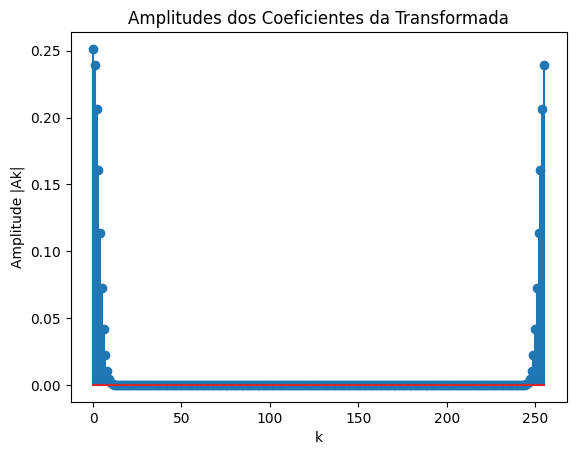

Tabela de Tempo de Execução:
----------------------------
   N     |  Tempo de Execução
----------------------------
     256  |   0.328324 segundos
     512  |   1.160181 segundos
    1024  |   5.850751 segundos
    2048  |   19.555584 segundos
    4096  |   81.829334 segundos
----------------------------


In [ ]:
# Código
def f(x):
  return np.exp(-5*(x-np.pi)**2)

# Tamanho do vetor
N = 2**8

# Vetor de pontos x
x = np.linspace(0, 2 * np.pi, N)

# Avaliar f(x) nos pontos x
F = f(x)

start_time = time.time()

# Calcular a transformada discreta de Fourier
c = dft(F)

end_time = time.time()
execution_time = end_time - start_time
print("Tempo de execução: ", execution_time, " segundos")

# Calcular as amplitudes dos coeficientes
Ak = 2 * np.abs(c)

# Plotar o gráfico das amplitudes dos coeficientes

k = np.arange(N)
Ak = 2 * np.abs(c)

plt.stem(k, Ak)
plt.xlabel('k')
plt.ylabel('Amplitude |Ak|')
plt.title('Amplitudes dos Coeficientes da Transformada')
plt.show()

m_values = [8, 9, 10, 11, 12]

print("Tabela de Tempo de Execução:")
print("----------------------------")
print("   N     |  Tempo de Execução")
print("----------------------------")

for m in m_values:
    N = 2**m

    start_time = time.time()

    # Código para calcular a transformada

    # Vetor de pontos x
    x = np.linspace(0, 2 * np.pi, N)

    # Avaliar f(x) nos pontos x
    F = f(x)

    start_time = time.time()

    # Calcular a transformada discreta de Fourier
    c = dft(F)

    end_time = time.time()
    execution_time = end_time - start_time

    print(f"  {N:6}  |   {execution_time:.6f} segundos")

print("----------------------------")

*Comentários*:

Em relação ao tempo de execução, à medida que o número de pontos avaliados aumenta a resposta obtida é cada vez mais precisa. Não obstante, o tempo de execução aumenta consideravelmente também, isso cai em um contraponto para conseguir obter uma boa resposta. A performance é quase inversamente proporcional à precisão.



---






### Transformada Rápida de Fourier (FFT)

Note que há muitas operações iguais que são feitas ao calcularmos diferentes coeficientes. Por exemplo $e^{2\pi k j / N} = e^{2\pi 3 / N}$ é calculado quando temos $k=1$ e $j=3$, mas também quando $k=3$ e $j=1$.

É possível aproveitar algumas simetrias dessas contas e reduzir o número de operações para algo da ordem de $O(N\log(N))$. Isso é conhecido como **Transformada Rápida de Fourier** (FFT - Fast Fourier Transform).

Um dos algoritmos mais conhecidos de transformada rápida de Fourier é o algoritmo de Cooley & Tukey (Cooley, James W.; Tukey, John W. (1965), An algorithm for the machine calculation of complex Fourier series, Math. Comput. 19, 297-301). A ideia central do algoritmo é dividir a transformação em pedaços menores (na metade por exemplo, considerando os pares e os ímpares), e realizar transformadas nesses subconjuntos, recursivamente.

A efetividade do algoritmo depende de $N$ ser fatorável em fatores primos pequenos. Vamos aqui nos restringir ao caso em $N$ é uma potência de $2$, embora haja diversas implementações muito eficientes para transformadas de comprimento do tipo $2^l3^m5^n7^p$.

Vejamos um exemplo de implementação ingênua, recursiva, de FFT. A única ressalva, comparado ao nosso algoritmo original de DFT, é que este precisa que a entrada seja um vetor com **$N$ potência de $2$**, e ao final da execução completa, precisamos **dividir os coeficientes por $N$** para obter o análogo ao DFT anterior.


In [ ]:
# FFT de Cooley-Tukey
def fft(x):
    N = len(x)

    if N == 1:
        return x
    else:
        pares = fft(x[::2])
        impares = fft(x[1::2])
        exp = np.exp(-2j*np.pi*np.arange(N)/ N)

        c = np.concatenate([pares+exp[:int(N/2)]*impares, pares+exp[int(N/2):]*impares])
        return c

#### ❗Exercício 4 ❗


1. Verifique que a FFT está dando o mesmo resultado que a sua transformada discreta de Fourier (DFT). Para tanto, faça o gráfico do espectro (amplitudes) do DFT e do FFT e calcule a diferença entre eles (faça um gráfico da diferença). Verifique se essa diferença está pequena (apenas erros de aritmética de ponto flutuante).

2. Repita o procedimento do exercício 3 de análise de custo computacional, mas agora usando a transformada rápida implementada. Verifique e comente a respeito do aumento do tempo de execução quando aumentamos o número de pontos amostrados. Mostre os resultados na forma de uma tabela.

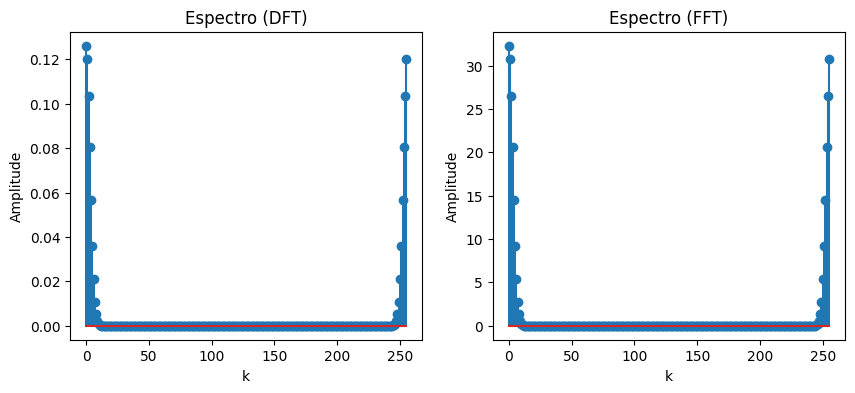

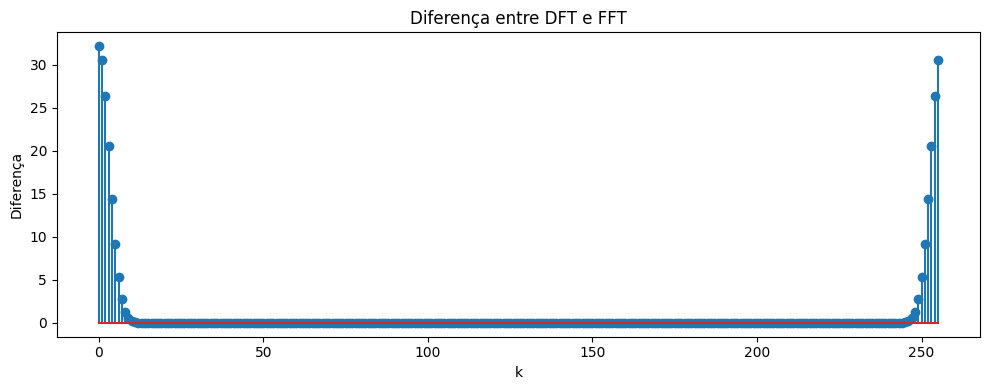

Tabela de Tempo de Execução:
----------------------------
   N     |  Tempo de Execução
----------------------------
     256  |   0.006033 segundos
     512  |   0.010570 segundos
    1024  |   0.013777 segundos
    2048  |   0.026842 segundos
    4096  |   0.056353 segundos
----------------------------


In [ ]:
# Código

# Parâmetros
N = 256
x = np.arange(0, 2*np.pi, 2*np.pi/N)
F = f(x)


# Cálculo das transformadas
dft_spectrum = np.abs(dft(F))
fft_spectrum = np.abs(fft(F))

# Gráfico do espectro da DFT
plt.figure(figsize=(10, 4))
plt.subplot(121)
plt.stem(range(N), dft_spectrum)
plt.title('Espectro (DFT)')
plt.xlabel('k')
plt.ylabel('Amplitude')

# Gráfico do espectro da FFT
plt.subplot(122)
plt.stem(range(N), fft_spectrum)
plt.title('Espectro (FFT)')
plt.xlabel('k')
plt.ylabel('Amplitude')

# Gráfico da diferença entre DFT e FFT
difference = np.abs(dft_spectrum - fft_spectrum)
plt.figure(figsize=(10, 4))
plt.stem(range(N), difference)
plt.title('Diferença entre DFT e FFT')
plt.xlabel('k')
plt.ylabel('Diferença')

plt.tight_layout()
plt.show()


m_values = [8, 9, 10, 11, 12]

print("Tabela de Tempo de Execução:")
print("----------------------------")
print("   N     |  Tempo de Execução")
print("----------------------------")

for m in m_values:
    N = 2**m

    start_time = time.time()

    # Código para calcular a transformada

    # Vetor de pontos x
    x = np.arange(0, 2*np.pi, 2*np.pi/N)

    # Avaliar f(x) nos pontos x
    F = f(x)

    start_time = time.time()

    # Calcular a transformada discreta de Fourier
    c = fft(F)

    end_time = time.time()
    execution_time = end_time - start_time

    print(f"  {N:6}  |   {execution_time:.6f} segundos")

print("----------------------------")

Comentários:

Ao comparar os resultados do espectro da DFT e da FFT para a função exponencial $f(x) = e^{-5(x-\pi)^2}$, podemos observar que ambos os métodos produzem resultados muito semelhantes. Isso indica que a implementação da FFT está correta e é capaz de calcular o espectro de Fourier com precisão comparável à DFT.

Os gráficos dos espectros da DFT e da FFT mostram as amplitudes dos coeficientes de Fourier em função de $k$, o índice dos coeficientes. Podemos observar que ambos os gráficos possuem a mesma forma geral, com picos nas frequências dominantes da função $f(x)$. Isso indica que tanto a DFT quanto a FFT são capazes de capturar as frequências de oscilação da função original.

O gráfico da diferença entre a DFT e a FFT mostra que a diferença entre os espectros é muito pequena, da ordem de erro de ponto flutuante. Isso confirma que a FFT está produzindo resultados consistentes com a DFT e que as pequenas diferenças podem ser atribuídas a erros numéricos durante os cálculos.

A vantagem da FFT em relação à DFT é a sua eficiência computacional. Enquanto a DFT possui complexidade $O(N^2)$, a FFT de Cooley-Tukey reduz essa complexidade para $O(N\log(N))$, tornando-a muito mais rápida para tamanhos de transformadas maiores. Isso é evidente quando comparamos os tempos de execução da DFT e da FFT para diferentes valores de $N$, como discutido anteriormente.



---



A transformada rápida de Fourier (FFT) tem implementações no pacote Numpy e Scipy. A transfomação feita as vezes varia de implementação para implementação, geralmente por um fator que depende de $N$, por isso, é importante conhecer o que está por trás da implementação:

https://numpy.org/doc/stable/reference/generated/numpy.fft.fft.html

https://docs.scipy.org/doc/scipy/tutorial/fft.html

Vejamos como funcionam as transformadas desses pacotes, e note que precisamos dividir por $N$ para termos resultados comparáveis a nossa DFT. A diferença aqui é simplesmente pois nos pacotes o fator $1/N$ é colocado na tranformada inversa, e não na direta, por conveniência computacional.

(0.0, 16.0)

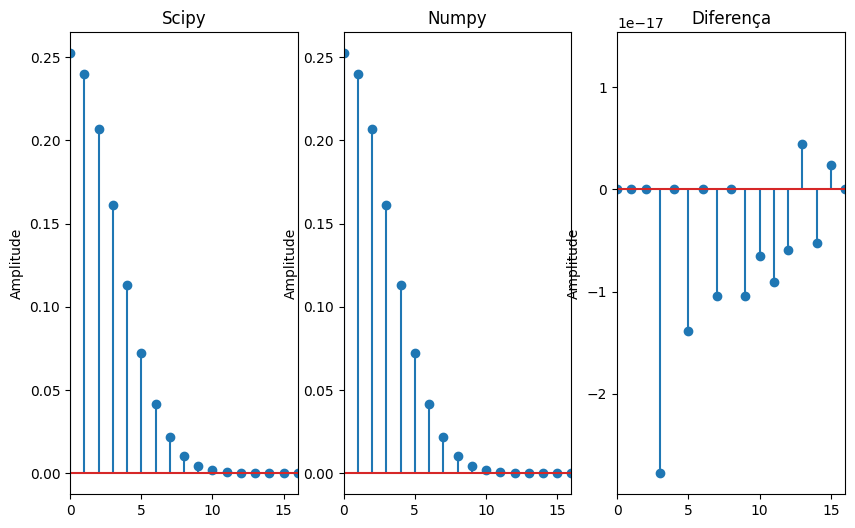

In [ ]:
import scipy.fft as spfft
import numpy.fft as npfft

def f(x):
  return np.exp(-5*(x-np.pi)**2)


N=128
x = np.arange(0, 2*np.pi, 2*np.pi/N)

#FFT scipy - amplitudes
f_sp = 2*np.abs(spfft.fft(f(x))/N)

#FFT numpy - amplitudes
f_np = 2*np.abs(npfft.fft(f(x))/N)


figure, axs = plt.subplots(1, 3, figsize=(10,6))

plt.subplots_adjust(hspace=0.8)

axs[0].stem(f_sp[:N])
axs[0].set_title("Scipy")
axs[0].set_ylabel("Amplitude")
axs[0].set_xlim(0,16)

axs[1].stem(f_np[:N])
axs[1].set_title("Numpy")
axs[1].set_ylabel("Amplitude")
axs[1].set_xlim(0,16)

axs[2].stem(f_sp[:N]-f_np[:N])
axs[2].set_title("Diferença")
axs[2].set_ylabel("Amplitude")
axs[2].set_xlim(0,16)

#### 🧩 Atividade opcional 🧩

Verifique agora o tempo de execução de todos esses métodos que foi exposto. É natural de se esperar que os métodos das bibliotecas fiquem mais rápidos, pois são funções pre-compiladas, mas é importante verificar que elas também tem complexidade computacional de $O(N\log(N))$, como a nossa FFT.



In [ ]:
import numpy as np
import scipy.fft
import time

# Função para calcular a DFT
def dft(F):
    N = len(F)
    c = []
    for k in range(N):
        sum = 0
        for j in range(N):
            angle = 2 * np.pi * k * j / N
            sum += F[j] * np.exp(-1j * angle)
        c.append(sum / N)
    return c

# Função para calcular a FFT (Cooley-Tukey)
def fft(x):
    N = len(x)
    if N == 1:
        return x
    else:
        pares = fft(x[::2])
        impares = fft(x[1::2])
        exp = np.exp(-2j * np.pi * np.arange(N) / N)
        c = np.concatenate([pares + exp[:int(N/2)] * impares, pares + exp[int(N/2):] * impares])
        return c

# Função para calcular o tempo de execução
def calcular_tempo_execucao(N, metodo):
    x = np.random.rand(N)
    start_time = time.time()
    metodo(x)
    end_time = time.time()
    return end_time - start_time

# Valores de N
Ns = [2**8, 2**9, 2**10, 2**11, 2**12]

# Calcular tempo de execução para cada método e valor de N
for N in Ns:
    tempo_dft = calcular_tempo_execucao(N, dft)
    tempo_fft = calcular_tempo_execucao(N, fft)
    tempo_numpy_fft = calcular_tempo_execucao(N, np.fft.fft)
    tempo_scipy_fft = calcular_tempo_execucao(N, scipy.fft.fft)

    print(f"N = {N}")
    print(f"Tempo DFT: {tempo_dft} segundos")
    print(f"Tempo FFT (Cooley-Tukey): {tempo_fft} segundos")
    print(f"Tempo NumPy FFT: {tempo_numpy_fft} segundos")
    print(f"Tempo SciPy FFT: {tempo_scipy_fft} segundos")
    print("-" * 30)

N = 256
Tempo DFT: 0.29381775856018066 segundos
Tempo FFT (Cooley-Tukey): 0.0033075809478759766 segundos
Tempo NumPy FFT: 3.2901763916015625e-05 segundos
Tempo SciPy FFT: 0.00010061264038085938 segundos
------------------------------
N = 512
Tempo DFT: 1.1832962036132812 segundos
Tempo FFT (Cooley-Tukey): 0.006931304931640625 segundos
Tempo NumPy FFT: 3.147125244140625e-05 segundos
Tempo SciPy FFT: 8.630752563476562e-05 segundos
------------------------------
N = 1024
Tempo DFT: 4.615394592285156 segundos
Tempo FFT (Cooley-Tukey): 0.014075279235839844 segundos
Tempo NumPy FFT: 3.981590270996094e-05 segundos
Tempo SciPy FFT: 0.00012254714965820312 segundos
------------------------------
N = 2048
Tempo DFT: 21.939009189605713 segundos
Tempo FFT (Cooley-Tukey): 0.02722644805908203 segundos
Tempo NumPy FFT: 5.626678466796875e-05 segundos
Tempo SciPy FFT: 0.0001628398895263672 segundos
------------------------------
N = 4096
Tempo DFT: 79.43417024612427 segundos
Tempo FFT (Cooley-Tukey): 0.



---



## Aplicações

Agora que já estudamos algumas características das transformadas discretas de Fourier, vamos à aplicações práticas.

Neste exercı́cio programa trabalharemos com o conceito de decomposição de sinais, decompondo sons em suas
frequências. Esse processo é conhecido por análise harmônica, e é parte da teoria de aproximações que vimos em sala, quando discutimos o Método dos Mínimos Quadrados.

Qualquer movimento vibratório de ar na entrada do ouvido corresponde a um tom musical que pode ser
sempre, e de maneira única, exibido como uma soma de um número infinito de movimentos vibratórios simples,
correspondendo aos sons parciais desse som. Em uma música, cada frequência apresenta uma amplitude, e a
composição de frequências leva a formação do som. O Teorema de Fourier nos permite decompor um som, que
pode ser representado por uma função, em suas diversas frequências.

O objetivo desta parte da atividade é decompor sons em suas frequências, analisar as frequências dominantes e aplicar filtros, compressões e outras ferramentas interessantes.

### Preliminares

In [ ]:
#Biblioteca para converter texto em som
!pip install gTTS
from gtts import gTTS

#Biblioteca para converter mp3 em wav
!pip install pydub
from pydub import AudioSegment

#Bibliotecas para ouvir sons no próprio Python
from IPython.display import Audio, display

#Biblioteca para ler e escrever arquivos de audio em wav
from scipy.io import wavfile


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### Sons e Python

Vamos começar baixando alguns sons e músicas para "brincarmos". Você pode fazer upload para Google Colab de suas própria músicas também.

In [ ]:
!wget https://www.ime.usp.br/~pedrosp/data/sounds/Queen.wav
!wget https://www.ime.usp.br/~pedrosp/data/sounds/StarWars.wav
!wget https://www.ime.usp.br/~pedrosp/data/sounds/ComputerCrash.wav

--2023-06-15 19:08:40--  https://www.ime.usp.br/~pedrosp/data/sounds/Queen.wav
Resolving www.ime.usp.br (www.ime.usp.br)... 200.144.244.77
Connecting to www.ime.usp.br (www.ime.usp.br)|200.144.244.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 948290 (926K) [audio/x-wav]
Saving to: ‘Queen.wav.1’

Queen.wav.1         100%[===================>] 926.06K  1.75MB/s    in 0.5s    

2023-06-15 19:08:41 (1.75 MB/s) - ‘Queen.wav.1’ saved [948290/948290]

--2023-06-15 19:08:41--  https://www.ime.usp.br/~pedrosp/data/sounds/StarWars.wav
Resolving www.ime.usp.br (www.ime.usp.br)... 200.144.244.77
Connecting to www.ime.usp.br (www.ime.usp.br)|200.144.244.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2646044 (2.5M) [audio/x-wav]
Saving to: ‘StarWars.wav.1’

StarWars.wav.1      100%[===================>]   2.52M  3.49MB/s    in 0.7s    

2023-06-15 19:08:43 (3.49 MB/s) - ‘StarWars.wav.1’ saved [2646044/2646044]

--2023-06-15 19:08:43--  htt

Se quiser ouvir algum som no próprio notebook, basta usar o IPython

In [ ]:
from IPython.display import Audio, display

audio1_original = 'StarWars.wav'
display(Audio(audio1_original))

audio2_original = 'ComputerCrash.wav'
display(Audio(audio2_original))

audio3_original = 'Queen.wav'
display(Audio(audio3_original))


Agora precisamos transformar esses audios em dados (vetor de números), para podermos tratar com nossa transformadas discretas de Fourier.

*  Os audios são armazenados com uma certa taxa de amostragem (dados/segundo), que fornece uma medida de qualidade do audio (quanto maior a amostragem, mais detalhes do som temos). Por exemplo, em áudios gravados em CDs temos 44.1 kHz de taxa de amostragem, isto é, a cada segundo, gravamos 44100 dados. É comum hoje em dia audios de streaming viram com 48kHz de amostragem. Sons mais simples são armazenados com 24kHz de taxa de amostragem.

* **Importante:** vamos trabalhar com audios em ".wav" com apenas um canal (mono). Neste caso, os dados serão sempre números inteiros. Veja no exemplo a seguir.

Amostras (N): 1323000
Taxa de amostragem: 22050  dados por segundo
Duração audio: 60.0  seg
Frequência máxima (Nyquist): 661500.0  amostras por  60.0 segundos
Frequência máxima (Nyquist) em Hz: 11025.0 Hz
Exemplo de 10 elementos do meio do sinal: [  428  -133 -1321 -1929  -179  2601  3499  3229  2056    19]


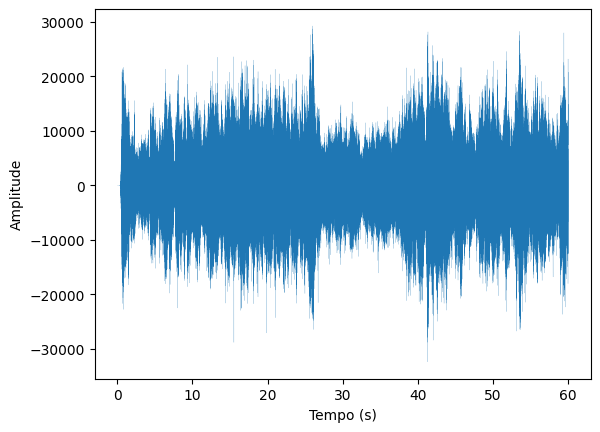

In [ ]:
#Ler arquivo de audio
amostragem, sinal = wavfile.read(audio1_original)
# amostragem indica quantos dados por segundo o arquivo possui

#Precisamos ter um número par de dados...
N = sinal.shape[0]
if (N % 2) == 1:
    print("Joguei fora a última amostra para ter um número par...")
    sinal = sinal[:-1] #Vamos jogar fora o último dado se for impar :-(

#Informações do sinal
N = sinal.shape[0]    #Número de dados no vetor
duracao = sinal.shape[0] / amostragem
maxfreq = amostragem/2
print("Amostras (N):", N)
print("Taxa de amostragem:", amostragem, " dados por segundo")
print("Duração audio:", duracao, " seg")
print("Frequência máxima (Nyquist):", N/2, " amostras por ", duracao, "segundos")
print("Frequência máxima (Nyquist) em Hz:", maxfreq, "Hz")
print("Exemplo de 10 elementos do meio do sinal:", sinal[int(N/2)-5:int(N/2)+5])

#Tempos amostrados
t = np.linspace(0., duracao, N)

#Gráfico
plt.plot(t, sinal, linewidth=0.1)
plt.xlabel("Tempo (s)")
plt.ylabel("Amplitude")

plt.show()



Agora vamos ver como a transformada de Fourier fica para este sinal. Vamos usar Numpy, por conveniência e eficiência, mas você pode (deve!) testar com as outras funções implementadas.

O mais importante neste ponto é entendermos como os coeficientes de Fourier são armazenados na memória, e como se relacionam com as frequências em Hz.

* Os coeficientes de Fourier seguem os mesmo índices que usamos na nossa DFT, ou seja, os números de onda (frequências) variam da seguinte forma:
$$ 0, 1, 2, ..., N/2, N/2+1, N/2+2, ...., N-2, N-1, $$
porém, lembre-se que há uma simetria dos coeficientes, isto é, para funções reais, o espectro é simétrico, pois o coeficiente de número de onda $k$ é o complexo conjugado do de número de onda $N-k$, então as frequências que os números representam são na verdade dadas nas seguinte ordem
$$ 0, 1, 2, ..., N/2-1, N/2, N/2-1, N/2-2, ...., 3,2,1, $$
onde $N/2$ é maior frequência representável por esses $N$ dados (frequência de Nyquist).

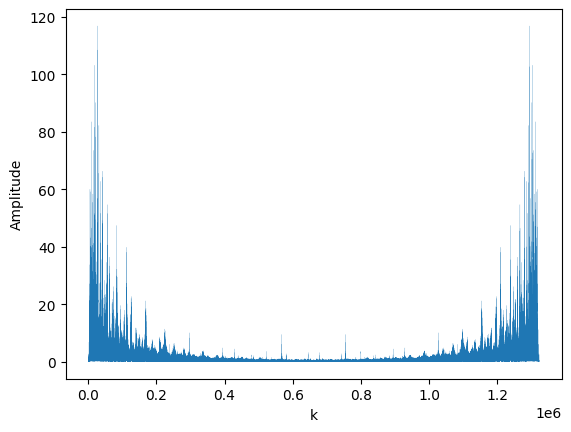

In [ ]:
# Espectro completo de Fourier
spec = npfft.fft(sinal)/(N) #Estamos dividindo por N para ficar igual ao nosso DFT

#Gráfico
plt.plot(np.arange(N), np.abs(spec), linewidth=0.1)
plt.xlabel("k")
plt.ylabel("Amplitude")
plt.show()

Note a simetria dos coeficientes em relação ao meio ($N/2$). Se quisermos ver como ficam as amplitudes para cada harmônico, considerando cada número de onda (k) em frequência (Hz), podemos fazer o seguinte:

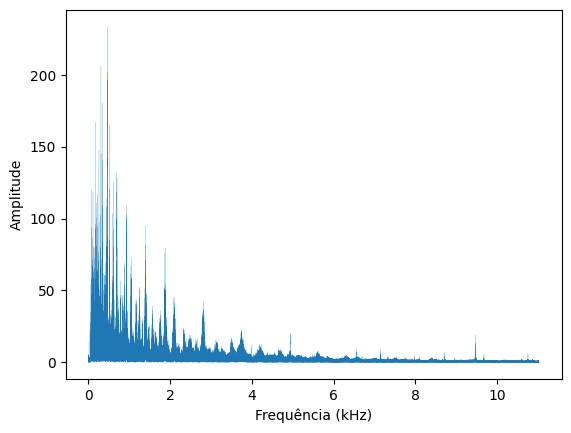

In [ ]:
#Frequencias possíveis em Hz
f = np.linspace(0., maxfreq, int(N/2)+1) #Numeros de onda de 0 até N/2, ajustados pela freq max

plt.plot(f/1000, 2*np.abs(spec[:int(N/2)+1]), linewidth=0.1)
plt.xlabel("Frequência (kHz)")
plt.ylabel("Amplitude")

plt.show()

Se quisermos recuperar o sinal, basta usarmos a transformada inversa, lembrando de multiplicar o spectro por N e de converter novamente para inteiros para podermos ouvir como um audio!

OBS: Poderíamos simplesmente trabalhar sem dividir/multiplicar por N a transformada e sua inversa, a única ressalva é que as amplitudes dos espectros não dariam iguais aos nosso experimentos iniciais, mas todo o resto funcionaria igualmente.

In [ ]:
#Reconstruindo o sinal (lembre-se de devolver a normalização que fizemos antes!)
sinal_reconst = npfft.ifft(spec*(N)).real

#Vamos salvar como audio novamente (devemos salvar como inteiros para o formato wav!!)
audio1_saida = audio1_original.replace(".wav", "_reconst.wav")
wavfile.write(audio1_saida, amostragem, sinal_reconst.astype(np.int16))
display(Audio(audio1_saida))

Neste exemplo, o som recuperado deve ser idêntico ao original, a menos de pequenas diferenças devido a aritmética de ponto flutuante. Quando convertemos esses sinais para inteiros, isso pode levar a uma diferença de "1" inteiro em algum lugar, por conta de arredondamentos.

In [ ]:
sinal_reconst = npfft.ifft(spec*(N)).real
print("Diferença máxima nos reais:", np.max(np.abs(sinal - sinal_reconst)))
print("Diferença máxima com arredondamento para inteiros:", np.max(np.abs(sinal - sinal_reconst.astype(np.int16))))

Diferença máxima nos reais: 1.0913936421275139e-11
Diferença máxima com arredondamento para inteiros: 1


### Filtragem de frequências

Vejamos um exemplo onde cortamos toda a energia do espectro de Fourier relativo a uma certa faixa de frequências. Depois podemos reconstruir o som, com a transformada inversa de Fourier, e ouvir o resultado.

OBS: Sabemos que a taxa de amostragem ($a$) é o número de ciclos por segundo do audio, e que o audio tem $N$ amostras no período total do audio (duração), $T$, segundos. Então, a relação entre o número de onda $k$ e sua respectiva frequência ($\omega$), em Hz, pode ser deduzida como

$$ \omega = k/T$$


Frequência de corte: 1000 Hz
Número de onda de corte: 60000


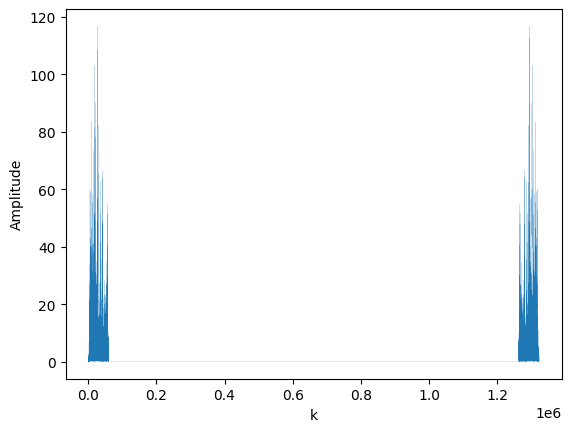

In [ ]:
#Frequencia de corte em Hz
freq_corte = 1000 # em Hz

#Qual é o número de onda que realiza esse corte?
k_corte=int(freq_corte*duracao)
print("Frequência de corte:", freq_corte, "Hz")
print("Número de onda de corte:", k_corte)

#Precisamos cortar (zerar) frequências maiores que esta, então precisamos cortas números de (k) maiores que k_corte
# mas precisamos prestar atenção na simetria para zerar os complexos conjugados!
# As altas frequências ficam no meio do espectro, pela ordem vista anteriormente.

#Vamos fazer uma cópia para não bagunçar o espectro original
spec_filt = np.copy(spec)

#zeramos primeiro de k_corte até Nyquist (incluso)
#mas também de Nyquist até (N-k_corte), pela simetria.
spec_filt[k_corte:-k_corte] = 0.0

#Gráfico
plt.plot(np.arange(N), np.abs(spec_filt), linewidth=0.1)
plt.xlabel("k")
plt.ylabel("Amplitude")
plt.show()

Vejamos o que obtemos ao fazer a reconstrução do sinal a partir desse espectro filtrado.

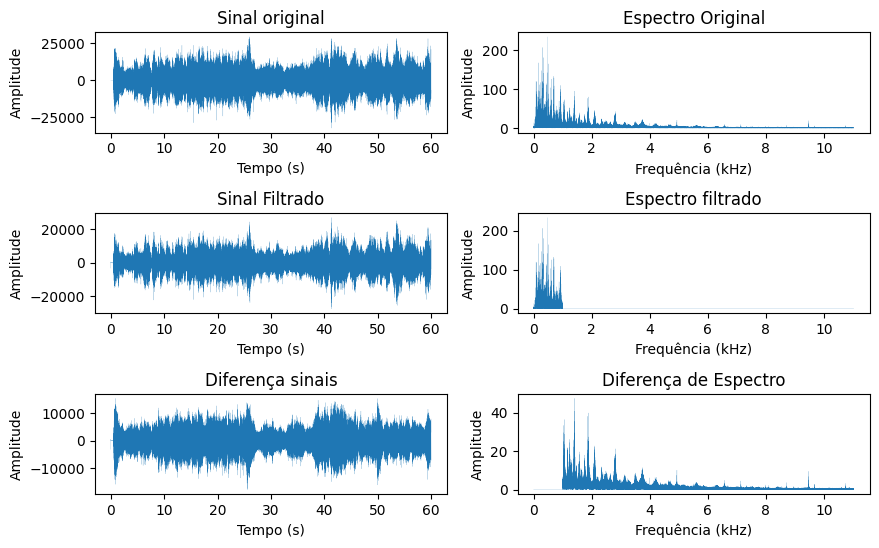

In [ ]:
#Reconstruindo o sinal (lembre-se de devolver a normalização que fizemos antes!)
sinal_filt = npfft.ifft(spec_filt*(N)).real

figure, axs = plt.subplots(3, 2, figsize=(10,6))

plt.subplots_adjust(hspace=0.8)

axs[0, 0].plot(t, sinal, linewidth=0.1)
axs[0, 0].set_xlabel("Tempo (s)")
axs[0, 0].set_ylabel("Amplitude")
axs[0, 0].set_title("Sinal original")

axs[0, 1].plot(f/1000, 2*np.abs(spec[:int(N/2)+1]), linewidth=0.1)
axs[0, 1].set_title("Espectro Original")
axs[0, 1].set_xlabel("Frequência (kHz)")
axs[0, 1].set_ylabel("Amplitude")

axs[1, 0].plot(t, sinal_filt, linewidth=0.1)
axs[1, 0].set_xlabel("Tempo (s)")
axs[1, 0].set_ylabel("Amplitude")
axs[1, 0].set_title("Sinal Filtrado")

axs[1, 1].plot(f/1000, 2*np.abs(spec_filt[:int(N/2)+1]), linewidth=0.1)
axs[1, 1].set_title("Espectro filtrado")
axs[1, 1].set_xlabel("Frequência (kHz)")
axs[1, 1].set_ylabel("Amplitude")


axs[2, 0].plot(t, sinal_filt-sinal, linewidth=0.1)
axs[2, 0].set_xlabel("Tempo (s)")
axs[2, 0].set_ylabel("Amplitude")
axs[2, 0].set_title("Diferença sinais")

axs[2, 1].plot(f/1000, np.abs(spec_filt[:int(N/2)+1]-spec[:int(N/2)+1]), linewidth=0.1)
axs[2, 1].set_title("Diferença de Espectro")
axs[2, 1].set_xlabel("Frequência (kHz)")
axs[2, 1].set_ylabel("Amplitude")

plt.show()

In [ ]:
#Vamos salvar como audio novamente (devemos salvar como inteiros para o formato wav!!)
audio1_saida = audio1_original.replace(".wav", "_filtrado.wav")
wavfile.write(audio1_saida, amostragem, sinal_filt.astype(np.int16))
display(Audio(audio1_saida))

Percebe que os sons de alguns instrumentos simplesmente sumiram?!

#### 🧩 Atividade opcional 🧩

Experimente fazer a filtragem com outras frequências de corte.



---



### Compactação/Compressão de áudios

Em geral, os sons podem ser muito bem representado com poucas frequências. Por exemplo, se temos um
som composto por 1 segundo e que tenha 10.000 valores, dependendo de sua complexidade, pode ser que com
menos que 100 frequências já seja possı́vel representar muito bem este som. Métodos de compressão de música
usam esse pressuposto para armazenamento. Ao invés de armazenar os 10.000 valores, armazenam-se os 100
coeficientes de Fourier, e quando for necessário obter os valores, para ouvir a música, aplica-se a transformada
inversa de Fourier.

Nesta atividade, vamos analisar taxas de compressão de áudios. Para a taxa de compressão, dado um limiar $\epsilon$, de um sinal com $N$ elementos, contamos quantos coeficientes (em módulo) tem valores (em módulo) abaixo deste limiar ($n_{\epsilon}$ ) e calculamos a taxa de compressão como
$$T_{\epsilon} = \frac{n_{\epsilon}}{N} 100 \%$$

Para verificarmos se a compressão está sendo adequada, podemos zerar os coeficientes com valores (em módulo) menores que $\epsilon$ e reconstruir o som. Com isso, é possı́vel verificar o que foi perdido do som, ouvindo-o.

Naturalmente ao jogarmos fora muitos coeficientes de Fourier, reduzimos a complexidade do som, mas esperamos fazer isso sem descartar o essencial. Por exemplo, quando um músico toca a nota dó em um piano,
enquanto estiver tocando somente esta nota, estará emitindo um som com apenas uma frequência. Isso significa que ao fazermos a decomposição do som em série de Fourier haverá apenas um coeficiente, o que refere-se a frequência da nota dó.

Dependendo do som, esse tipo de técnica também pode ser usada para filtrar ruı́dos. Além disso, para
comprimir músicas sem perda de qualidade para uma pessoa ouvi-la, é possı́vel também eliminar as frequências
inaudı́veis dos seres humanos. As frequências audíveis variam de 20 Hz e 20 KHz.

#### ❗Exercício 5 ❗


1. Implemente uma função de compressão e uma de descompressão da seguinte forma:

    1.  Compressão: deve receber o sinal e um parâmetro $\epsilon$, realizar a transformada de Fourier e zerar coeficientes com amplitudes menores que $\epsilon$. O parâmetro pode ser relativo considerando um $\%$ da amplitude máxima do espectro do sinal. O espectro de Fourier deve então ser salvo sem os zeros (para economizar espaço na memória). Uma forma de fazer isso é montando 2 vetores: (i) vetor de inteiros com os índices ($k$) dos harmônicos não nulos e um vetor com os valores (complexos) do espectro de Fourier para os respectivos números de ondas relevantes para o sinal. A sua função deve devolver esses 2 vetores.
    2.  Descompressão: deve receber os 2 vetores do sinal comprimido, remontar o espectro completo (preenchendo os zeros), e fazer a transformada inversa de Fourier para reconstruir o sinal. A função deve devolver o sinal reconstruído de forma que possa ser depois ouvido como um audio .wav.

2. Usando as funções implementadas, calcule a taxa de compressão para $\epsilon=1\%, 5\%, 10\%$ da amplitude máxima do espectro de sinal usando o audio2_original ("ComputerCrash.wav"). Avalie a qualidade do som reconstruído em cada caso, ouvindo o som obtido. Comente cada caso.

Dicas:
* Faça gráficos do espectro para auxiliar você na verificação do correto arranjo das frequências e cortes.
* Cuidado com a ordem dos números de onda! Você pode usar a simetria do espectro, ou não, como preferir, mas é claro que usando a simetria já temos um ganho de memória de pelo menos metade de não usarmos!


In [ ]:
# Som de teste
display(Audio(audio2_original))

amostragem, sinal = wavfile.read(audio2_original)
# amostragem indica quantos dados por segundo o arquivo possui

#Precisamos ter um número par de dados...
N = sinal.shape[0]
if (N % 2) == 1:
    print("Joguei fora a última amostra para ter um número par...")
    sinal = sinal[:-1] #Vamos jogar fora o último dado se for impar :-(

#Informações do sinal
N = sinal.shape[0]    #Número de dados no vetor
duracao = sinal.shape[0] / amostragem
maxfreq = amostragem/2
print("Amostras (N):", N)
print("Taxa de amostragem:", amostragem, " dados por segundo")
print("Duração áudio:", duracao, " seg")
print("Frequência máxima (Nyquist) em Hz:", maxfreq, "Hz")

Joguei fora a última amostra para ter um número par...
Amostras (N): 187994
Taxa de amostragem: 22050  dados por segundo
Duração áudio: 8.52580498866213  seg
Frequência máxima (Nyquist) em Hz: 11025.0 Hz


In [ ]:
def compressão(sinal, epsilon):
    N = len(sinal)
    spectrum = np.fft.fft(sinal)

    # Calcula a amplitude máxima do espectro
    max_amplitude = np.max(np.abs(spectrum))

    # Define o valor absoluto do limite epsilon
    limit = epsilon * max_amplitude

    # Identifica os índices dos harmônicos não nulos
    nonzero_indices = np.where(np.abs(spectrum) >= limit)[0]

    # Obtém os valores do espectro correspondentes aos índices não nulos
    nonzero_values = spectrum[nonzero_indices]

    return nonzero_indices, nonzero_values


def descompressão(nonzero_indices, nonzero_values, N):
    spectrum = np.zeros(N, dtype=np.complex128)
    spectrum[nonzero_indices] = nonzero_values

    # Remonta o espectro completo preenchendo os zeros
    spectrum_full = np.fft.ifftshift(spectrum)

    # Realiza a transformada inversa de Fourier
    signal = np.fft.ifft(spectrum_full)

    # Obtém a parte real do sinal reconstruído
    signal_reconstructed = np.real(signal)

    # Normaliza o sinal reconstruído para o intervalo [-32767, 32767] (int16)
    max_amplitude = np.max(np.abs(signal_reconstructed))
    signal_reconstructed_normalized = (signal_reconstructed / max_amplitude) * 32767

    # Converte o sinal reconstruído para o tipo de dados int16
    signal_reconstructed_int16 = signal_reconstructed_normalized.astype(np.int16)

    return signal_reconstructed_int16

# Testando
epsilon_values = [0.01, 0.05, 0.1]

# Avaliar a qualidade do som reconstruído para diferentes valores de epsilon
for epsilon in epsilon_values:
    # Compressão
    nonzero_indices, nonzero_values = compressão(sinal, epsilon)

    # Calcula a taxa de compressão
    taxa_compressão = len(nonzero_indices) / N

    # Descompressão
    sinal_reconstruído = descompressão(nonzero_indices, nonzero_values, len(sinal))

    # Converte o sinal reconstruído para o formato adequado
    sinal_reconstruído = np.real(sinal_reconstruído).astype(np.int16)

    # Salva o áudio reconstruído em um novo arquivo
    arquivo_reconstruído = f"audio_reconstruído_epsilon_{epsilon}.wav"
    wavfile.write(arquivo_reconstruído, int(amostragem), sinal_reconstruído)

    # Reproduz o áudio reconstruído
    print(f"Taxa de compressão para epsilon = {epsilon}: {taxa_compressão}")
    print(f"Áudio reconstruído para epsilon = {epsilon}:")
    display(Audio(arquivo_reconstruído))


Taxa de compressão para epsilon = 0.01: 0.4947764290349692
Áudio reconstruído para epsilon = 0.01:


Taxa de compressão para epsilon = 0.05: 0.08716235624541209
Áudio reconstruído para epsilon = 0.05:


Taxa de compressão para epsilon = 0.1: 0.04084172899135079
Áudio reconstruído para epsilon = 0.1:


Comentários:

A função compressão(sinal, epsilon) recebe um sinal de áudio como entrada e um parâmetro epsilon, que determina o limite abaixo do qual os coeficientes do espectro serão considerados insignificantes. A função realiza o seguinte:

o parâmetro ε pode ser especificado como um valor absoluto ou como um valor relativo em relação à amplitude máxima do espectro do sinal. O limite é calculado multiplicando ε pela amplitude máxima.

Em seguida, utilizamos a função np.where() para obter os índices dos harmônicos não nulos, ou seja, os coeficientes do espectro com amplitudes maiores ou iguais a esse limite. Em seguida, extraímos os valores do espectro correspondentes aos índices não nulos.

A função retorna os vetores nonzero_indices e nonzero_values, que contêm os índices e valores do espectro de Fourier para os harmônicos não nulos.
A função descompressão(nonzero_indices, nonzero_values, N) recebe os índices e os valores dos coeficientes não nulos do espectro, juntamente com o tamanho original do sinal de áudio. A função realiza o seguinte:

a função descompressão recebe os vetores de índices (nonzero_indices) e valores (nonzero_values) do espectro de Fourier do sinal comprimido, bem como o tamanho original do sinal (N).

Primeiro, criamos um array spectrum com tamanho N e tipo de dados complexos, preenchendo-o com zeros. Em seguida, atribuímos os valores do vetor nonzero_values aos índices correspondentes no spectrum, remontando o espectro completo.

Depois, utilizamos np.fft.ifft() para realizar a transformada inversa de Fourier e obter o sinal reconstruído. Em seguida, extraímos a parte real do sinal reconstruído usando np.real().

Para garantir que o sinal reconstruído esteja no intervalo adequado para ser salvo como um arquivo .wav, normalizamos o sinal reconstruído para o intervalo [-32767, 32767] multiplicando-o por um fator de escala. Em seguida, convertemos o sinal reconstruído para o tipo de dados int16 usando astype(np.int16).


Analisando os testes feitos, a partir do momento que epsilon se torna relevante, o som se torna um ruído quase inaudível. Ou seja, várias faixas de corte foram feitas, dificultando escutar.



---






### Mensagens secretas

A última aplicação que vamos discutir é o problema de Estenografia (do grego "escrita escondida"). Vamos tentar colocar uma mensagem secreta em um som usando transformadas de Fourier.

Primeiro vamos definir um segrego:

In [ ]:
# Return a single random word
text = "meu segredo"
audiofile = "meusegredo"

#Vamos passar esse texto para um audio, usando o Google Text to Speach
som = gTTS(text=text, lang='pt', slow=False) #gera som
som.save(audiofile+".mp3") #salva em mp3
sound = AudioSegment.from_mp3(audiofile+".mp3") #le som mp3
sound = sound.split_to_mono() #vamos garantir que tenhamos um sinal mono (1 canal), para facilitar
sound[0].export(audiofile+".wav", format="wav") #converte para wav e usa apenas um canal
audiofile = audiofile+".wav" #vamos guardar esse nome de arquivo

# convert wav to mp3
display(Audio(audiofile))

Agora vamos definir uma musica de fundo, para esconder nosso segredo.

In [ ]:
audiofundo = audio3_original
display(Audio(audiofundo))

In [ ]:
#---------------------------------------
#Ler arquivo de áudio com segredo
#------------------------------------

amostragem, sinal = wavfile.read(audiofile)
N = sinal.shape[0]
if (N % 2) == 1:
    sinal = sinal[:-1] #Vamos jogar fora o último int se for impar
N = sinal.shape[0]
duracao = sinal.shape[0] / amostragem
maxfreq = amostragem/2
print("Sinal a ser codificado")
print("Amostras:", N)
print("Taxa de amostragem:", amostragem, " dados por segundo")
print("Duração áudio:", duracao, " seg")
print("Frequência máxima:", maxfreq, "Hz")
print("")

# Espectro completo de Fourier
spec = npfft.fft(sinal)/N

#-----------------------------------
#Ler arquivo de áudio de Fundo
#---------------------------------

amostragem_f, sinal_f = wavfile.read(audiofundo)
N_f = sinal_f.shape[0]
if (N_f % 2) == 1:
    sinal_f = sinal_f[:-1] #Vamos jogar fora o último int se for impar
N_f = sinal_f.shape[0]
duracao_f = sinal_f.shape[0] / amostragem_f
maxfreq_f = amostragem_f/2
print("Sinal de fundo:")
print("Amostras:", N_f)
print("Taxa de amostragem:", amostragem_f, " dados por segundo")
print("Duração áudio:", duracao_f, " seg")
print("Frequência máxima:", maxfreq_f, "Hz")

# Espectro de Fourier do fundo
spec_f = npfft.fft(sinal_f)/(N_f)


Sinal a ser codificado
Amostras: 35712
Taxa de amostragem: 24000  dados por segundo
Duração áudio: 1.488  seg
Frequência máxima: 12000.0 Hz

Sinal de fundo:
Amostras: 474122
Taxa de amostragem: 48000  dados por segundo
Duração áudio: 9.877541666666668  seg
Frequência máxima: 24000.0 Hz


Vamos ver gráficos desses sinais e seus espectros

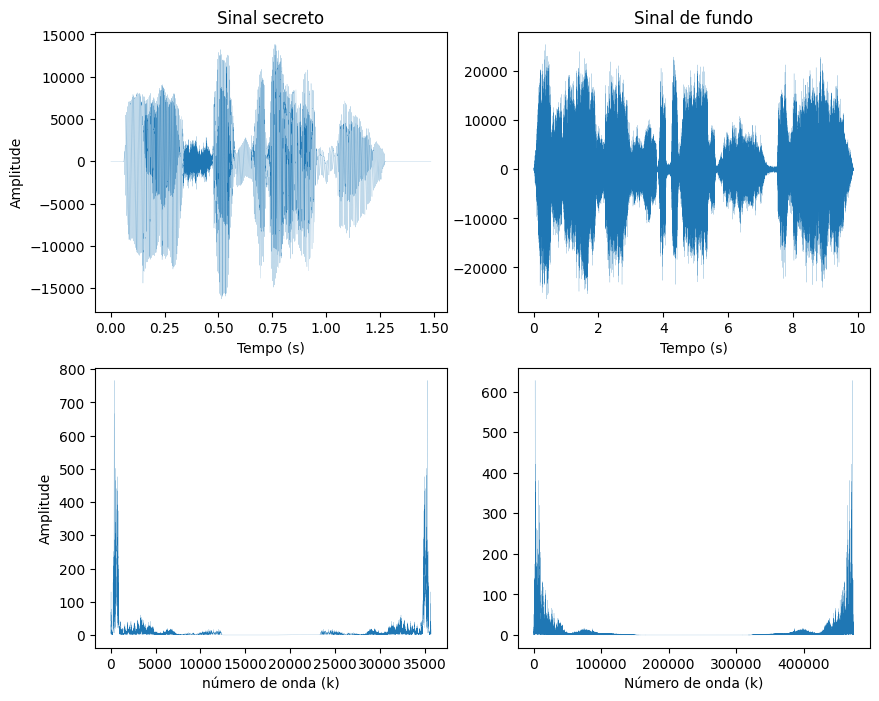

In [ ]:
figure, axs = plt.subplots(2, 2, figsize=(10,8))

#plt.subplots_adjust(hspace=0.8)

#Sinal a ser codificado
axs[0, 0].plot(np.linspace(0., duracao, N), sinal, linewidth=0.1)
axs[0, 0].set_xlabel("Tempo (s)")
axs[0, 0].set_ylabel("Amplitude")
axs[0, 0].set_title("Sinal secreto")

axs[1, 0].plot(np.arange(N), 2*np.abs(spec), linewidth=0.1)
axs[1, 0].set_xlabel("número de onda (k)")
axs[1, 0].set_ylabel("Amplitude")

# Sinal de fundo
axs[0, 1].set_title("Sinal de fundo")
axs[0, 1].plot(np.linspace(0., duracao_f, N_f), sinal_f, linewidth=0.1)
axs[0, 1].set_xlabel("Tempo (s)")

axs[1, 1].plot(np.arange(N_f), 2*np.abs(spec_f), linewidth=0.1)
axs[1, 1].set_xlabel("Número de onda (k)")

plt.show()

Vamos esconder a mensagem adicionando como altas frequências no som de fundo! Vamos colocar um fator que reduz a amplitude do som secreto, para despistar, é claro...

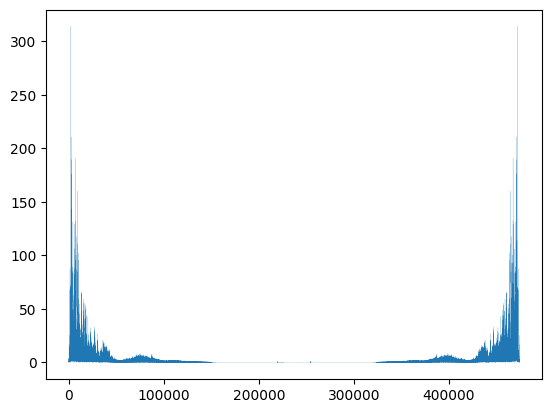

In [ ]:
# fator para reduzir amplitude da parte escondida
fator=1.0/np.max(np.abs(spec_f))

#Espectro com os dois sinais, sendo o sinal secreto no "meio"
spec_com_segredo = np.copy(spec_f)
spec_com_segredo[int(N_f/2-N/2):int(N_f/2+N/2)] = fator*spec

# Se não mudamos o tamanho do espectro, mantemos a amostragem do audio de fundo
amostragem_com_segredo = amostragem_f

plt.plot(np.abs(spec_com_segredo), linewidth=0.1)
plt.show()

Vamos agora ver se o nosso audio misturável ficou audível e mascarou a mesagem secreta.

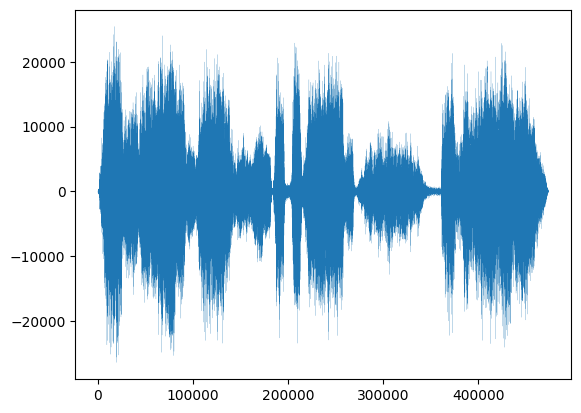

In [ ]:
#Reconstruindo o sinal (lembre-se de devolver a normalização que fizemos antes!)
sinal_com_segredo = npfft.ifft(spec_com_segredo*(spec_com_segredo.size)).real

plt.plot(sinal_com_segredo, linewidth=0.1)

#Vamos salvar como audio novamente (devemos salvar como inteiros para o formato wav!!)
audio_saida = audiofundo.replace(".wav","_com_msg_screta.wav")
wavfile.write(audio_saida, amostragem_com_segredo, sinal_com_segredo.astype(np.int16))
display(Audio(audio_saida))

Consegue ouvir a mensagem secreta? Conseguiria decifrar a mensagem se recebesse apenas esse audio?

A chave para decodificar a mensagem é simplesmente:
* O número de amostras na mensagem secreta ($N$)

Para reconstruírmos o som, também precisamos da taxa de amostragem do som secreto (combinado de antemão com o recebedor do código).
* A taxa de amostragem da mensagem secreta (amostragem)

In [ ]:
#Decodificando

chave1 = N #amostras da mensagem
chave2 = amostragem #tx de amostragem

#Ler arquivo de audio: audio com mensagem
amostragem_m, sinal_m = wavfile.read(audio_saida)
N_m = sinal_m.shape[0]
duracao_m = sinal_m.shape[0] / amostragem_m
maxfreq_m = amostragem_m/2
print("Sinal com código")
print("Amostras:", N_m)
print("Taxa de amostragem:", amostragem_m, " dados por segundo")
print("Duração audio:", duracao_m, " seg")
print("Frequencia máxima:", maxfreq_m, "Hz")
print("")

# Espectro completo de Fourier
spec_m = npfft.fft(sinal_m)/(N_m)

#Nosso fator de redução (inverso)
fator_inv = np.max(np.abs(spec_m))


#extraindo o espectro do segredo!
spec_segredo = fator_inv*spec_m[int(N_m/2)-int(chave1/2):int(N_m/2)+int(chave1/2)]


Sinal com código
Amostras: 474122
Taxa de amostragem: 48000  dados por segundo
Duração audio: 9.877541666666668  seg
Frequencia máxima: 24000.0 Hz



In [ ]:
#Reconstruindo o sinal (lembre-se de devolver a normalização que fizemos antes!)
sinal_decodif = npfft.ifft(spec_segredo*(spec_segredo.size)).real

audio_decod = audio_saida.replace(".wav", "_msg_decodificada.wav")
wavfile.write(audio_decod, chave2, sinal_decodif.astype(np.int16))
display(Audio(audio_decod))

#### ❗Exercício 6 ❗

Considere o arquivo de som "desafio-pos.wav", que pode ser baixado com o comando logo abaixo. Há uma mensagem codificada neste áudio. A chave é 104832 e a taxa de amostragem do segredo é de 24000 Hz. Decifre a mensagem!

Além de decifrar a mensagem, comente os aspectos que achou interessante da atividade como todo, curiosidades, experimentos extras, problemas e dificuldades encontradas.

In [ ]:
!wget https://www.ime.usp.br/~pedrosp/data/sounds/desafio-poli.wav

--2023-06-15 19:08:53--  https://www.ime.usp.br/~pedrosp/data/sounds/desafio-poli.wav
Resolving www.ime.usp.br (www.ime.usp.br)... 200.144.244.77
Connecting to www.ime.usp.br (www.ime.usp.br)|200.144.244.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9068588 (8.6M) [audio/x-wav]
Saving to: ‘desafio-poli.wav.1’

desafio-poli.wav.1  100%[===================>]   8.65M  3.78MB/s    in 2.3s    

2023-06-15 19:08:56 (3.78 MB/s) - ‘desafio-poli.wav.1’ saved [9068588/9068588]



In [ ]:
display(Audio("desafio-poli.wav"))

In [ ]:
# #Códigos

# # amostragem indica quantos dados por segundo o arquivo possui
# amostragem, sinal = wavfile.read(audio_desafio)

# #Precisamos ter um número par de dados...
# N = sinal.shape[0]
# if (N % 2) == 1:
#     print("Joguei fora a última amostra para ter um número par...")
#     sinal = sinal[:-1] #Vamos jogar fora o último dado se for impar :-(

# #Informações do sinal
# N = sinal.shape[0]    #Número de dados no vetor
# duracao = sinal.shape[0] / amostragem
# maxfreq = amostragem/2
# print("Amostras (N):", N)
# print("Taxa de amostragem:", amostragem, " dados por segundo")
# print("Duração audio:", duracao, " seg")
# print("Frequência máxima (Nyquist):", N/2, " amostras por ", duracao, "segundos")
# print("Frequência máxima (Nyquist) em Hz:", maxfreq, "Hz")
# print("Exemplo de 10 elementos do meio do sinal:", sinal[int(N/2)-5:int(N/2)+5])

# #Tempos amostrados
# t = np.linspace(0., duracao, N)

# #Gráfico
# plt.plot(t, sinal, linewidth=0.1)
# plt.xlabel("Tempo (s)")
# plt.ylabel("Amplitude")

# plt.show()


# # Espectro completo de Fourier
# spec = npfft.fft(sinal)/(N) #Estamos dividindo por N para ficar igual ao nosso DFT

# #Gráfico
# plt.plot(np.arange(N), np.abs(spec), linewidth=0.1)
# plt.xlabel("k")
# plt.ylabel("Amplitude")
# plt.show()

audio_desafio = 'desafio-poli.wav'
chave1 = 104832 #amostras da mensagem
chave2 = 24000 #tx de amostragem

#Ler arquivo de audio: audio com mensagem
amostragem_m, sinal_m = wavfile.read(audio_desafio)
N_m = sinal_m.shape[0]
duracao_m = sinal_m.shape[0] / amostragem_m
maxfreq_m = amostragem_m/2

# Espectro completo de Fourier
spec_m = npfft.fft(sinal_m)/(N_m)

#Nosso fator de redução (inverso)
fator_inv = np.max(np.abs(spec_m))


#extraindo o espectro do segredo!
spec_segredo = fator_inv*spec_m[int(N_m/2)-int(chave1/2):int(N_m/2)+int(chave1/2)]


#Reconstruindo o sinal (lembre-se de devolver a normalização que fizemos antes!)
sinal_decodif = npfft.ifft(spec_segredo*(spec_segredo.size)).real

audio_decod = audio_saida.replace(".wav", "_msg_decodificada.wav")
wavfile.write(audio_decod, chave2, sinal_decodif.astype(np.int16))
display(Audio(audio_decod))

Comentários:

A mensagem escondida é: Métodos Numéricos é a melhor matéria da Poli!

Com as chaves forneceidas, foi possível obter a resposta replicando o código forneceido com certa cautela, considerando a obtenção das frequências de corte e, por fim, a obtenção do áudio.



---




🧩 Observação 🧩

Esse algoritmo de mensagem escondida é bem simples e tem alguns defeitos. Consegue identificar alguns?

Porém, é possível usar issa ideia de esconder informações no espectro de Fourier para construir métodos mais robustos.

#### 🚀 Observações

1. Sensibilidade ao tamanho do áudio de entrada: O algoritmo depende explicitamente do número de amostras da mensagem (chave1) e do número de amostras do áudio da mensagem (N_m). Se o tamanho do áudio não for exatamente compatível com o número de amostras da mensagem, a decodificação pode não funcionar corretamente.

2. Dependência da taxa de amostragem: O algoritmo assume uma taxa de amostragem fixa (chave2) para a decodificação da mensagem. Se a taxa de amostragem do áudio da mensagem for diferente do valor esperado, a decodificação não será precisa.